In [1]:
# from jadeR import jadeR
from jadeR_cupy import jadeR_cupy
import pandas as pd
from wfield import *
import pickle
import sys
import os
sys.path.append(os.path.dirname(os.getcwd()))
from NatMovie_utils import *


In [2]:
# %% set path and parameter

path_wfield = r'/home/lzx/data/WF_VC_liuzhaoxi/25.01.11_U26/natural-movie/process/20250111-214859-wfield'
experiment = os.path.basename(path_wfield)[:15]
mouse = os.path.normpath(path_wfield).split(os.sep)[5].split('_')[1]
path_out_ICA = pjoin(path_wfield, '..', experiment + '-natural-movie--', f'{mouse}-{experiment}-ICA')
os.makedirs(path_out_ICA, exist_ok=True)
rawPath = pjoin(path_wfield, '../../raw')
trialfile = pd.read_csv(pjoin(path_wfield, 'trials.csv'), header=None).values.astype(int)
movie_folder = pjoin(rawPath, 'natural_movies')
movie_list = pd.read_csv(pjoin(movie_folder, 'movie_list.txt'), header=None).values
n_movie = movie_list.size
movie_name_list = []
for imovie in range(n_movie):
    movie_name_list.append(str(movie_list[imovie])[2:-6])

n_frame = 150  # 帧


In [3]:
os.environ['CUDA_VISIBLE_DEVICES'] = '1'
import cupy as cp

cp._default_memory_pool.free_all_blocks()

In [4]:
# load wfield data 

U = cp.load(pjoin(path_wfield, 'U.npy')).astype('float32')
SVT = cp.load(pjoin(path_wfield, 'SVT.npy')).astype('float32')
SVT_470 = SVT[:,::2]
SVT_405 = SVT[:,1::2]
SVTcorr = SVT_470-SVT_405
# SVTcorr = cp.load(pjoin(path_wfield, 'SVTcorr.npy')).astype('float32')
frames_average = np.load(pjoin(path_wfield, 'frames_average.npy'))
frames_ave = frames_average[0]
tif_height, tif_width = frames_average.shape[1:]

In [5]:
pre_length = 20
after_lenth = 30
# SVTcorr_sort维度：[nSVD, n_frame, n_movie, n_rep]
SVTcorr_sort = Gsorting_NatMov(SVTcorr, trialfile[:, 1], n_movie, n_frame, pre_length, after_lenth).astype('float32')
n_rep = SVTcorr_sort.shape[-1]
tif_sort1 = cp.tensordot(U, SVTcorr_sort, axes=(2, 0)).astype('float32')
tif_sort=cp.asnumpy(tif_sort1)
# np.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_tif_sort.npy'), tif_sort)
print('finish reconstruct tif')
# tif_sort维度：[width, height, n_frame, n_movie, n_rep]

finish reconstruct tif


In [ ]:
# %%time
# tif_corr = reconstruct(U, SVTcorr)

In [6]:
# load CCF

from wfield import *

lmarks = load_allen_landmarks(pjoin(path_wfield, '../../../dorsal_cortex_landmarks.json'))
ccf_regions_reference, proj, brain_outline = allen_load_reference('dorsal_cortex')
# this loads the untransformed atlas
atlas_im, areanames, brain_mask = atlas_from_landmarks_file(pjoin(path_wfield, '../../../dorsal_cortex_landmarks.json'),
                                                            do_transform=True)
# this converts the reference to image space (unwarped)
ccf_regions_im = allen_transform_regions(lmarks['transform'], ccf_regions_reference,
                                         resolution=lmarks['resolution'],
                                         bregma_offset=lmarks['bregma_offset'])


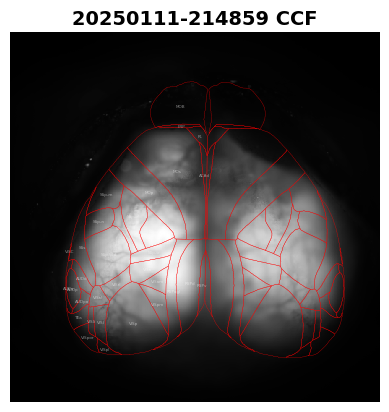

In [7]:
# plot avg_frame & CCF

fig = plt.figure()
plt.imshow(frames_average[0], cmap='gray')
for i, r in ccf_regions_im.iterrows():
    plt.plot(r['left_x'], r['left_y'], 'r', lw=0.2)
    plt.plot(r['right_x'], r['right_y'], 'r', lw=0.2)
    plt.text(r.left_center[0], r.left_center[1], r.acronym, color='w', va='center', fontsize=3, alpha=0.5, ha='center')

plt.axis('off')
plt.title(experiment+' CCF')
fig.set_facecolor('white')
plt.savefig(pjoin(path_out_ICA, '..', f'{mouse}_{experiment}_ccf.png'), bbox_inches='tight', pad_inches=0)
plt.show()


### ~~~~~~~~~~~~~~~~~~ start spatial ICA ~~~~~~~~~~~~~~~~~~~~

In [8]:
# set ICA parameter

ICA_methods = 'jade'
n_IC = 20


In [9]:
# X = tif_corr.reshape(SVTcorr.shape[-1], -1)

# tif_sort维度：[width, height, n_frame, n_movie, n_rep]
X = tif_sort1.reshape(tif_width*tif_height, -1).T
print('ICA dim:', X.shape)

ICA dim: (14000, 262144)


In [ ]:
%%time
if ICA_methods == 'jade':
    demix_matrix = jadeR_cupy(X, m=n_IC, verbose=True)
    IC = demix_matrix @ X
    IC_array = cp.asnumpy(IC).reshape(n_IC, *U.shape[:-1])
    mix_matrix = cp.asnumpy(cp.linalg.pinv(demix_matrix))
    
    del X, demix_matrix, IC
    cp._default_memory_pool.free_all_blocks()
    
elif ICA_methods == 'fast':
    from sklearn.decomposition import FastICA
    tif_corr_bin2 = tif_corr.reshape(tif_corr.shape[0], tif_corr.shape[1]//2, 2, tif_corr.shape[2]//2, 2).mean(axis=(2, 4))
    X_bin2 = tif_corr_bin2.reshape(tif_corr.shape[0], -1)
    fastica = FastICA(n_components=n_IC, whiten="arbitrary-variance")
    IC = fastica.fit_transform(X_bin2.T).T  
    mix_matrix = fastica.mixing_ 
    IC_array_bin2 = np.asarray(IC).reshape(n_IC, *tif_corr_bin2.shape[1:])
    IC_array = np.kron(IC_array_bin2, np.ones((1, 2, 2)))
    
np.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_spatial_IC{n_IC}.npy'), IC_array)
np.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_IC{n_IC}_mix.npy'), mix_matrix)
print('save ICA matrix')
print('IC_array.shape', IC_array.shape)
print('mix_matrix.shape', mix_matrix.shape)

jade -> Looking for 20 sources
jade -> Removing the mean value
jade -> Whitening the data
jade -> Estimating cumulant matrices
jade -> Contrast optimization by joint diagonalization
jade -> Sweep #  0
completed in 190 rotations
jade -> Sweep #  1
completed in 190 rotations
jade -> Sweep #  2
completed in 190 rotations
jade -> Sweep #  3
completed in 190 rotations
jade -> Sweep #  4
completed in 190 rotations
jade -> Sweep #  5
completed in 190 rotations
jade -> Sweep #  6
completed in 190 rotations
jade -> Sweep #  7
completed in 190 rotations
jade -> Sweep #  8
completed in 190 rotations
jade -> Sweep #  9
completed in 190 rotations
jade -> Sweep # 10
completed in 190 rotations
jade -> Sweep # 11
completed in 190 rotations
jade -> Sweep # 12
completed in 190 rotations
jade -> Sweep # 13
completed in 190 rotations
jade -> Sweep # 14
completed in 190 rotations
jade -> Sweep # 15
completed in 190 rotations
jade -> Sweep # 16
completed in 190 rotations
jade -> Sweep # 17
completed in 189 

In [10]:
IC_array=np.load(pjoin(path_out_ICA, f'{mouse}_{experiment}_spatial_IC{n_IC}.npy'))
mix_matrix=np.load(pjoin(path_out_ICA, f'{mouse}_{experiment}_IC{n_IC}_mix.npy'))
# mix_matrix_sort = np.load(pjoin(path_out_ICA, f'{mouse}_{experiment}_IC{n_IC}_mix_matrix_sort.npy'))


In [11]:
print('tif_sort.shape', tif_sort1.shape, 
      '\nX.shape', X.shape, 
      '\nIC_array.shape', IC_array.shape, 
      '\nmix_matrix.shape', mix_matrix.shape)

tif_sort.shape (512, 512, 200, 14, 5) 
X.shape (14000, 262144) 
IC_array.shape (20, 512, 512) 
mix_matrix.shape (14000, 20)


In [12]:
# caculate raw data spatial variance

total_var = cp.var(X, axis=1).sum()  
cp.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_total_var.npy'), total_var)

In [13]:
# 计算每个 spatial IC 解释的方差比例

ic_variances = cp.zeros(n_IC)
for i in range(n_IC):
    # 计算当前 IC 的贡献（时间序列 * 空间模式）
    ic_contribution = mix_matrix[:, i:i+1] @ IC_array[i].reshape(1, -1)  
    # 计算该 IC 的方差贡献
    ic_variances[i] = cp.var(ic_contribution, axis=1).sum() 

explained_variance_ratio = cp.asnumpy(ic_variances / total_var)

print("每个 spatial IC 解释的方差比例：")
for i, ratio in enumerate(explained_variance_ratio):
    print(f"IC {i+1}: {ratio * 100:.2f}%")

cp.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_explained_var_ratio.npy'), explained_variance_ratio)



每个 spatial IC 解释的方差比例：
IC 1: 11.61%
IC 2: 8.72%
IC 3: 8.48%
IC 4: 8.23%
IC 5: 7.65%
IC 6: 5.24%
IC 7: 4.48%
IC 8: 4.28%
IC 9: 3.81%
IC 10: 3.73%
IC 11: 3.48%
IC 12: 3.43%
IC 13: 3.33%
IC 14: 3.26%
IC 15: 3.15%
IC 16: 2.65%
IC 17: 2.60%
IC 18: 2.45%
IC 19: 2.37%
IC 20: 2.13%


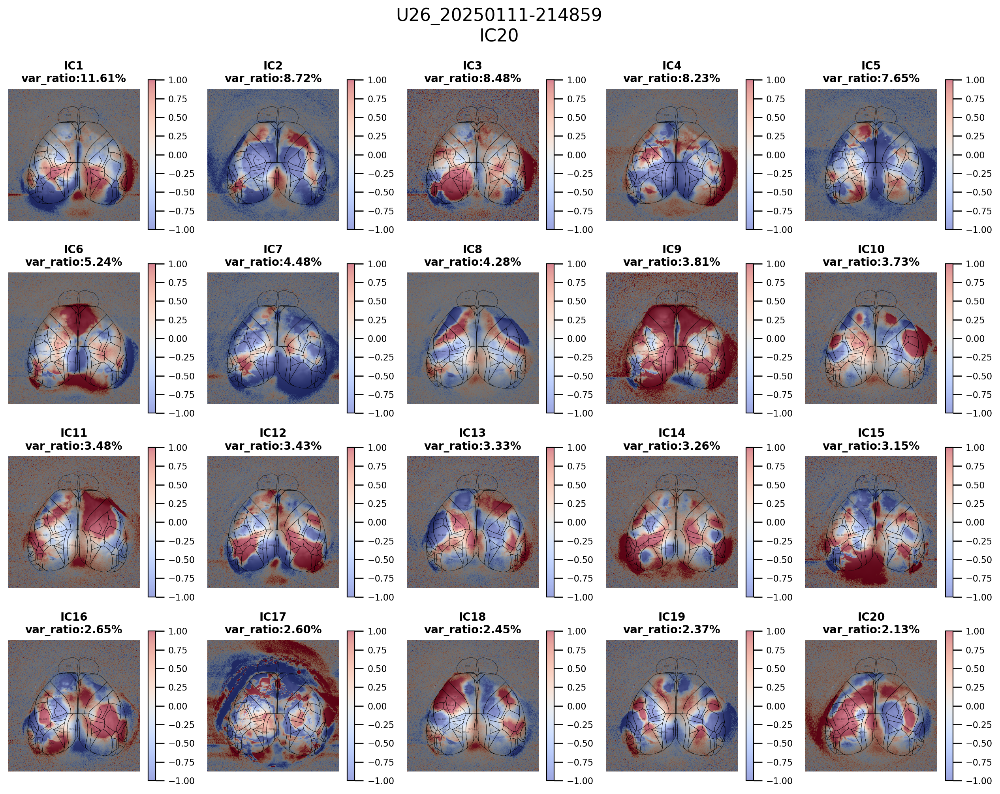

CPU times: user 15.2 s, sys: 397 ms, total: 15.6 s
Wall time: 15.7 s


In [15]:
%%time
# plot spatial IC

nrow = 4
ncol = 5
dpi = 200

fig, ax = plt.subplots(nrow, ncol, figsize=(U.shape[0] / dpi * ncol, U.shape[1] / dpi * nrow), dpi=dpi)
for irow in range(nrow):
    for icol in range(ncol):
        iIC = irow * ncol + icol
        ax[irow, icol].imshow(frames_ave, cmap='gray')
        img = ax[irow, icol].imshow(IC_array[iIC], cmap='coolwarm', clim=[-1,1], alpha=0.5)

        ax[irow, icol].set_title(f'IC{iIC + 1}\nvar_ratio:{explained_variance_ratio[iIC]*100:.2f}%', fontsize=10)
        ax[irow, icol].axis('off')

        for idx, r in ccf_regions_im.iterrows():
            ax[irow, icol].plot(r['left_x'], r['left_y'], 'k', lw=0.2)
            ax[irow, icol].plot(r['right_x'], r['right_y'], 'k', lw=0.2)
            ax[irow, icol].text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=2,
                                alpha=0.5,
                                ha='center')
        fig.colorbar(img)
fig.set_facecolor('white')
fig.suptitle(f'{mouse}_{experiment}\nIC{n_IC}', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.99])
plt.savefig(pjoin(path_out_ICA, f'{mouse}_{experiment}_spatial-IC{n_IC}_raw.png'), bbox_inches='tight', pad_inches=0)

plt.show()


In [17]:
# set IC threshold, adjust ± sign

def zscore(matrix, axis=(1,2)):
    mean = np.mean(matrix, axis=axis)
    std = np.std(matrix, axis=axis)
    zscore_matrix = (matrix - mean[:,None,None]) / std[:,None,None]
    return zscore_matrix


IC_arrayz = zscore(IC_array)
IC_arrayz_cut = np.copy(IC_arrayz)

z_cut = 3
IC_arrayz_cut[np.abs(IC_arrayz_cut) < z_cut] = 0
# IC_arrayz_cut[np.abs(IC_arrayz_cut) >= z_cut] = 1
ic_sign = np.where(np.mean(IC_arrayz_cut, axis=(1,2)) < 0, -1, 1)
IC_arrayz_cut = ic_sign[:, None, None] * IC_arrayz_cut  # 确保IC方向为正
mix_matrix = ic_sign * mix_matrix

In [18]:
##find cluster

def find_cluster(binary_image,area):
    """

    binary_image: (size1,size2),is a 2D matrix that has already been binarized
    area: int, the minimum area of the cluster,50~100 is a good choice for me
    """
    from scipy.ndimage import label, find_objects
    labeled_array, cluster_num = label(binary_image)
    print(f'cluster_num: {cluster_num}')
    objects = find_objects(labeled_array)
    new_binary_image = np.zeros_like(binary_image)
    for i in range(1,cluster_num+1):
        cluster = (labeled_array == i)
        new_binary_image[cluster] = cluster.sum()>=area
    return new_binary_image


IC_arrayz_cut_cluster = np.zeros((n_IC, tif_height, tif_width))
for iIC in range(n_IC):
    IC_arrayz_cut_cluster[iIC]=find_cluster(IC_arrayz_cut[iIC],100)
np.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_IC{n_IC}_cut{z_cut}_cluster.npy'), IC_arrayz_cut_cluster)


cluster_num: 23
cluster_num: 10
cluster_num: 66
cluster_num: 84
cluster_num: 9
cluster_num: 24
cluster_num: 52
cluster_num: 11
cluster_num: 169
cluster_num: 7
cluster_num: 11
cluster_num: 31
cluster_num: 17
cluster_num: 32
cluster_num: 75
cluster_num: 13
cluster_num: 408
cluster_num: 8
cluster_num: 6
cluster_num: 22


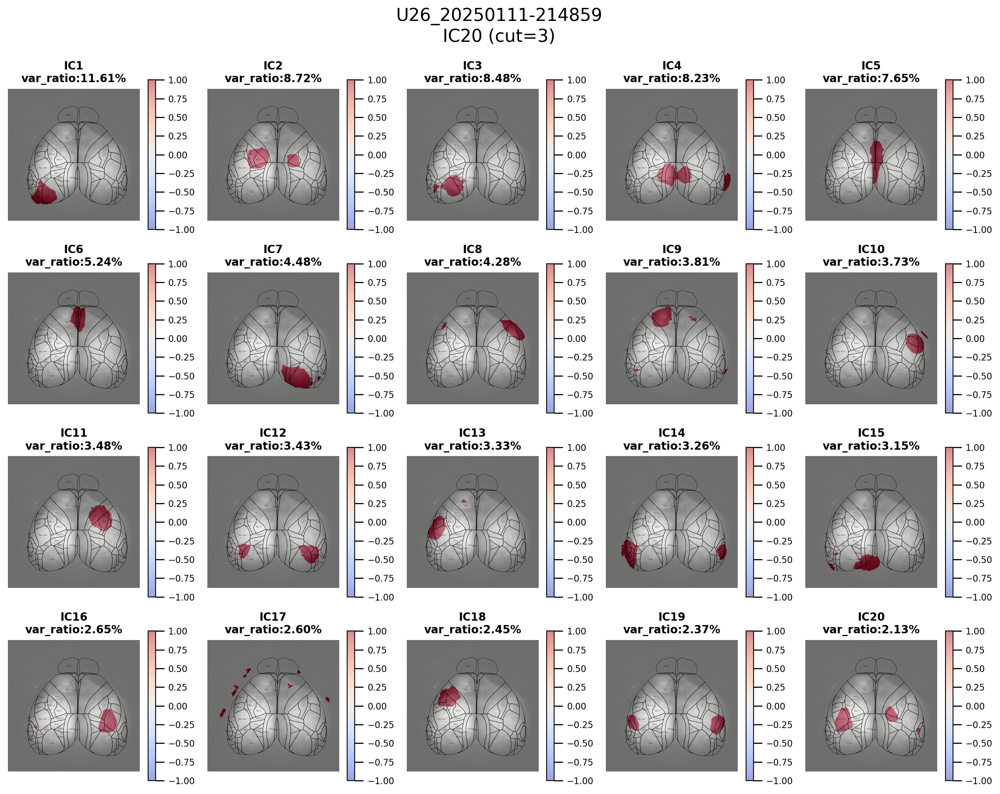

CPU times: user 12.4 s, sys: 310 ms, total: 12.7 s
Wall time: 12.8 s


In [21]:
%%time
# plot spatial IC

nrow = 4
ncol = 5
dpi = 200

fig, ax = plt.subplots(nrow, ncol, figsize=(U.shape[0] / dpi * ncol, U.shape[1] / dpi * nrow), dpi=dpi)
for irow in range(nrow):
    for icol in range(ncol):
        iIC = irow * ncol + icol
        ax[irow, icol].imshow(frames_ave, cmap='gray')
        img = ax[irow, icol].imshow(IC_arrayz_cut_cluster[iIC], cmap='coolwarm', clim=[-1,1], alpha=0.5)
        ax[irow, icol].set_title(f'IC{iIC + 1}\nvar_ratio:{explained_variance_ratio[iIC]*100:.2f}%', fontsize=10)
        ax[irow, icol].axis('off')

        for idx, r in ccf_regions_im.iterrows():
            ax[irow, icol].plot(r['left_x'], r['left_y'], 'k', lw=0.2)
            ax[irow, icol].plot(r['right_x'], r['right_y'], 'k', lw=0.2)
            ax[irow, icol].text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=2,
                                alpha=0.5,
                                ha='center')
        fig.colorbar(img)
fig.set_facecolor('white')
fig.suptitle(f'{mouse}_{experiment}\nIC{n_IC} (cut={z_cut})', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.99])
plt.savefig(pjoin(path_out_ICA, f'{mouse}_{experiment}_IC{n_IC}.png'), bbox_inches='tight', pad_inches=0)
plt.show()


In [22]:
from skimage.transform import warp

ccf_regions = allen_transform_regions(None,ccf_regions_reference,
                                      resolution = lmarks['resolution'],
                                        bregma_offset = lmarks['bregma_offset'])

IC_arrayz_cut_cluster_warped = warp(IC_arrayz_cut_cluster.transpose(1,2,0),lmarks['transform'],
                order = 1, mode='constant', cval = 0, clip=True, preserve_range=True, output_shape=(540, 640)).transpose(2,0,1)
np.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_IC{n_IC}_cut{z_cut}_cluster_warped.npy'), IC_arrayz_cut_cluster_warped)

frames_average_warped = warp(frames_average.transpose(1,2,0),lmarks['transform'],
                order = 1, mode='constant', cval = 0, clip=True, preserve_range=True, output_shape=(540, 640)).transpose(2,0,1)


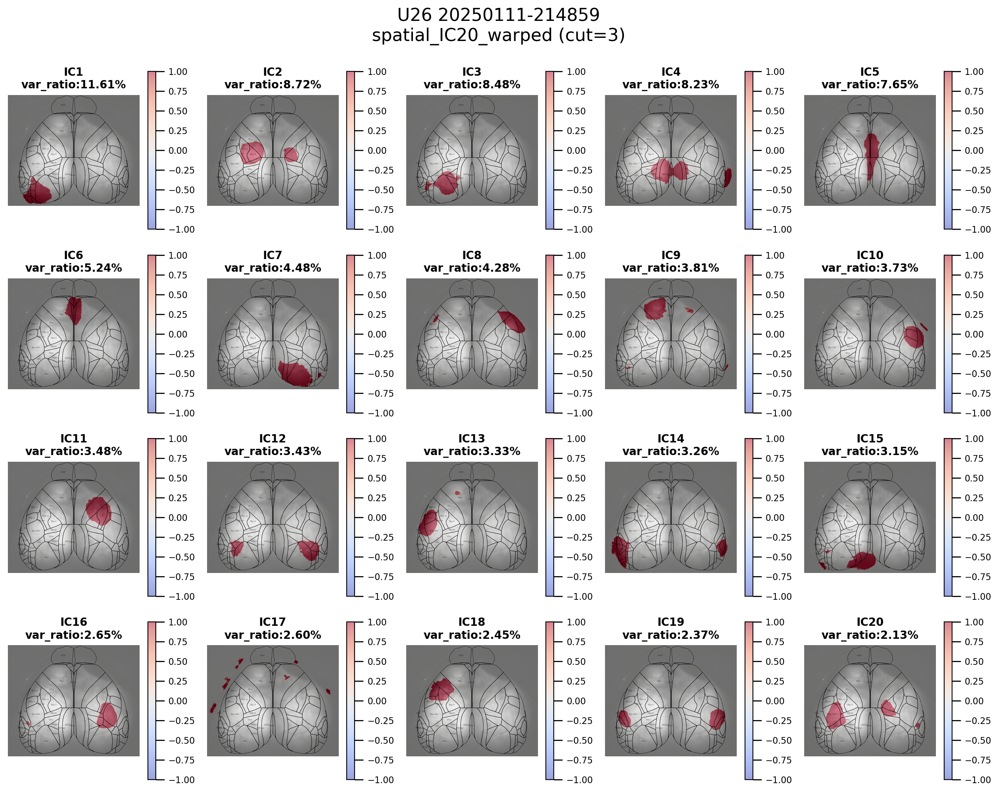

In [23]:
# plot warped spatial IC

nrow = 4
ncol = 5
dpi = 200

fig, ax = plt.subplots(nrow, ncol, figsize=(U.shape[0] / dpi * ncol, U.shape[1] / dpi * nrow), dpi=dpi)
for irow in range(nrow):
    for icol in range(ncol):
        iIC = irow * ncol + icol
        ax[irow, icol].imshow(frames_average_warped[0], cmap='gray')
        img = ax[irow, icol].imshow(IC_arrayz_cut_cluster_warped[iIC], cmap='coolwarm', clim=[-1, 1], alpha=0.5)
        ax[irow, icol].set_title(f'IC{iIC + 1}\nvar_ratio:{explained_variance_ratio[iIC]*100:.2f}%', fontsize=10)
        ax[irow, icol].axis('off')

        for idx, r in ccf_regions.iterrows():
            ax[irow, icol].plot(r['left_x'], r['left_y'], 'k', lw=0.2)
            ax[irow, icol].plot(r['right_x'], r['right_y'], 'k', lw=0.2)
            ax[irow, icol].text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=2,
                                alpha=0.5,
                                ha='center')
        fig.colorbar(img)
fig.set_facecolor('white')
fig.suptitle(f'{mouse} {experiment}\nspatial_IC{n_IC}_warped (cut={z_cut})', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.99])
plt.savefig(pjoin(path_out_ICA, f'{mouse}_{experiment}_spatial-IC{n_IC}_warped.png'), bbox_inches='tight', pad_inches=0)
plt.show()


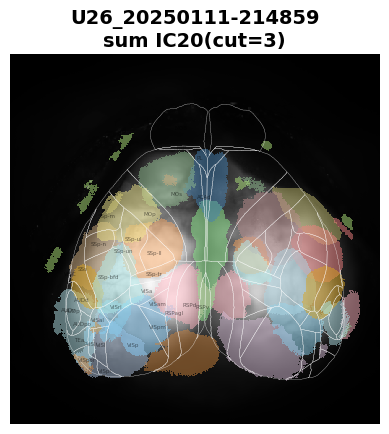

In [24]:
# plot superimposed spatial IC

from matplotlib.colors import ListedColormap

color_list = [
    "#B0C4DE", "#F4A460", "#87CEFA", "#FFB6C1", "#90EE90", "#4682B4", "#D8BFD8", 
    "#BDB76B", "#8FBC8F", "#F08080", "#BC8F8F", "#87CEEB", "#CDAA7D", "#B0E0E6", 
    "#CD853F", "#ADD8E6", "#B0E57C", "#F0E68C", "#DAA520", "#AFEEEE", "#DDA0DD", 
    "#A52A2A", "#8B4513", "#5F9EA0", "#F5DEB3", "#D2B48C", "#F4C2C2", "#E6E6FA", 
    "#EEE8AA", "#B4CDCD", "#FFE4B5", "#E0FFFF", "#DB7093", "#468499", "#FFD700", 
    "#40E0D0", "#FF6347", "#7FFFD4", "#FF7F50", "#9370DB", "#FF69B4", "#00CED1", 
    "#FFA07A", "#20B2AA", "#FF4500", "#FF8C00", "#6495ED", "#FF6347", "#4169E1", 
    "#DA70D6", "#98FB98", "#FF1493", "#32CD32", "#00FA9A", "#F08080", "#FFDAB9", 
    "#BA55D3", "#00FF7F", "#8A2BE2", "#4682B4", "#F5DEB3", "#00BFFF"
]


fig,ax = plt.subplots()
plt.imshow(frames_ave, cmap='gray')

# 逐个叠加IC，使用不同颜色
for i in range(n_IC):
    cmap = ListedColormap(['None', color_list[i]])
    plt.imshow(IC_arrayz_cut_cluster[i], cmap=cmap, interpolation='nearest', alpha=0.5)

for i, r in ccf_regions_im.iterrows():
    plt.plot(r['left_x'], r['left_y'], 'w', lw=0.2)
    plt.plot(r['right_x'], r['right_y'], 'w', lw=0.2)
    plt.text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=4, alpha=0.5, ha='center')

# plot_borders(retino['finalPatchesMarked'], plotAxis=ax, title=None, zoom=1,
#                  borderWidth=1, isColor=True, plotName=True, fontSize=7)

plt.axis('off')
# plt.colorbar()
fig.set_facecolor('white')
plt.title(f'{mouse}_{experiment}\nsum IC{n_IC}(cut={z_cut})')
plt.savefig(pjoin(path_out_ICA, f'{mouse}_{experiment}_sum IC{n_IC}___colored.png'), bbox_inches='tight', pad_inches=0)
plt.show()

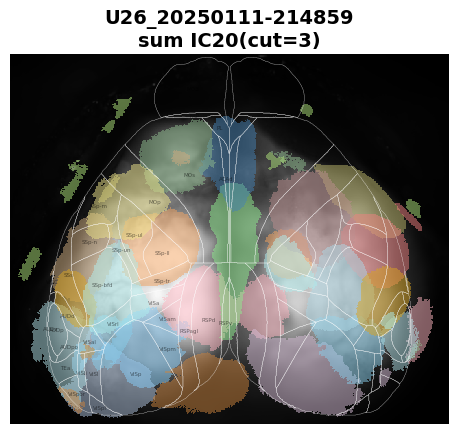

In [25]:
# plot warped superimposed spatial IC

from matplotlib.colors import ListedColormap

color_list = [
    "#B0C4DE", "#F4A460", "#87CEFA", "#FFB6C1", "#90EE90", "#4682B4", "#D8BFD8", 
    "#BDB76B", "#8FBC8F", "#F08080", "#BC8F8F", "#87CEEB", "#CDAA7D", "#B0E0E6", 
    "#CD853F", "#ADD8E6", "#B0E57C", "#F0E68C", "#DAA520", "#AFEEEE", "#DDA0DD", 
    "#A52A2A", "#8B4513", "#5F9EA0", "#F5DEB3", "#D2B48C", "#F4C2C2", "#E6E6FA", 
    "#EEE8AA", "#B4CDCD", "#FFE4B5", "#E0FFFF", "#DB7093", "#468499", "#FFD700", 
    "#40E0D0", "#FF6347", "#7FFFD4", "#FF7F50", "#9370DB", "#FF69B4", "#00CED1", 
    "#FFA07A", "#20B2AA", "#FF4500", "#FF8C00", "#6495ED", "#FF6347", "#4169E1", 
    "#DA70D6", "#98FB98", "#FF1493", "#32CD32", "#00FA9A", "#F08080", "#FFDAB9", 
    "#BA55D3", "#00FF7F", "#8A2BE2", "#4682B4", "#F5DEB3", "#00BFFF"
]


fig,ax = plt.subplots()
plt.imshow(frames_average_warped[0], cmap='gray')

# 逐个叠加IC，使用不同颜色
for i in range(n_IC):
    cmap = ListedColormap(['None', color_list[i]])
    plt.imshow(IC_arrayz_cut_cluster_warped[i], cmap=cmap, interpolation='nearest', alpha=0.5)

for i, r in ccf_regions.iterrows():
    plt.plot(r['left_x'], r['left_y'], 'w', lw=0.2)
    plt.plot(r['right_x'], r['right_y'], 'w', lw=0.2)
    plt.text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=4, alpha=0.5, ha='center')

# plot_borders(retino['finalPatchesMarked'], plotAxis=ax, title=None, zoom=1,
#                  borderWidth=1, isColor=True, plotName=True, fontSize=7)

plt.axis('off')
# plt.colorbar()
fig.set_facecolor('white')
plt.title(f'{mouse}_{experiment}\nsum IC{n_IC}(cut={z_cut})')
plt.savefig(pjoin(path_out_ICA, f'{mouse}_{experiment}_sum IC{n_IC}___colored_warped.png'), bbox_inches='tight', pad_inches=0)
plt.show()

In [26]:
# align timecourse

# pre_length = 20
# after_length = 30
# # mix_matrix.T: [n_IC, n_frame] 
# # timecourse: [n_IC, n_frame, n_movie, n_rep]
# timecourse = sorting_NatMov(mix_matrix.T, trialfile[:, 1], n_movie, n_frame, pre_length, after_length).astype('float32')
timecourse = mix_matrix.T.reshape(n_IC, *SVTcorr_sort.shape[1:])
np.save(pjoin(path_out_ICA, f'{mouse}_{experiment}_IC{n_IC}_timecourse.npy'), timecourse)
print('timecourse.shape: (n_IC, n_frame, n_movie, n_rep) ', timecourse.shape)
# n_rep = timecourse.shape[-1] 
# # timecourse_mean = np.mean(timecourse, axis=3)


timecourse.shape: (n_IC, n_frame, n_movie, n_rep)  (20, 200, 14, 5)


In [32]:
# plot all IC timecourse

subplot_timecourse(timecourse.transpose(0,2,1,3), list(range(1,21)), movie_name_list, title=f'{mouse}_{experiment}_all ICA{n_IC}_timecourse', outpath=path_out_ICA, pre_length=20, n_frame=150, plot_rep=False, dpi=200)


timecourse_snr.shape (20, 14)


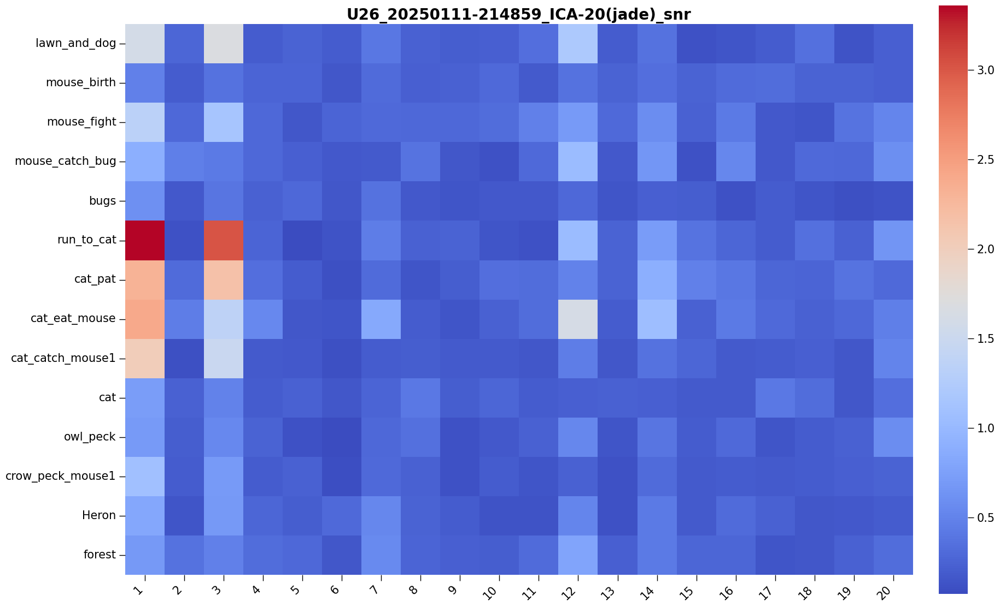

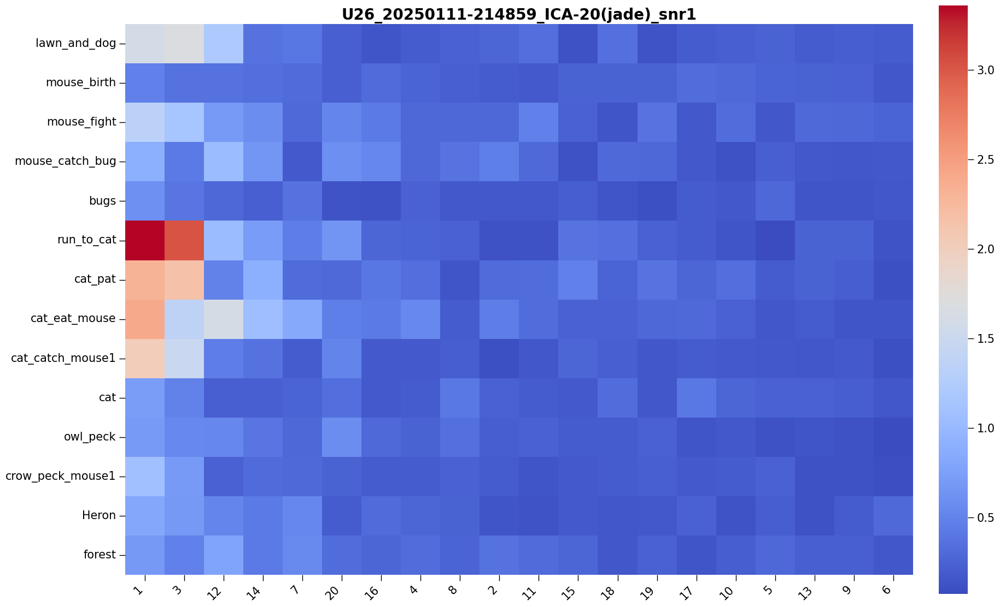

timecourse1.shape (10, 14, 200, 5)


In [27]:
# select top10 SNR ICs.

timecourse_snr = cal_snr(timecourse, axis1=3, axis2=1)
print('timecourse_snr.shape', timecourse_snr.shape)

IC_idx = np.argsort(np.mean(timecourse_snr, axis=1))[::-1]
timecourse_snr1=timecourse_snr[IC_idx]

plot_heatmap(timecourse_snr.T, xlabel=range(1,n_IC+1), ylabel=movie_name_list, cmap='coolwarm',
             title=f'{mouse}_{experiment}_ICA-{n_IC}({ICA_methods})_snr', dpi=300,annot=False, 
             outfile=pjoin(path_out_ICA, f'{mouse}_{experiment} ICA{n_IC}_snr.png'))
plot_heatmap(timecourse_snr1.T, xlabel=IC_idx+1, ylabel=movie_name_list, cmap='coolwarm',
             title=f'{mouse}_{experiment}_ICA-{n_IC}({ICA_methods})_snr1', dpi=300,annot=False,
             outfile=pjoin(path_out_ICA, f'{mouse}_{experiment} ICA{n_IC}_snr1.png'))

timecourse1=timecourse[IC_idx[:10]].transpose(0,2,1,3)
print('timecourse1.shape', timecourse1.shape)

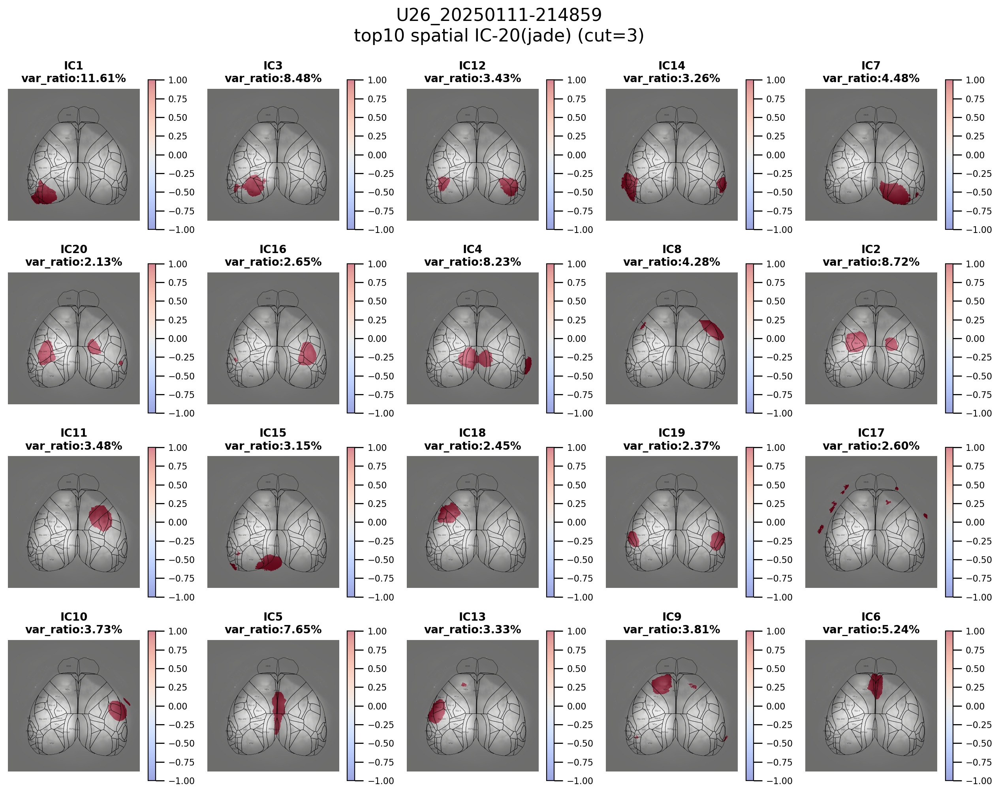

In [29]:
# plot top10 spatial IC

IC_arrayz_cut_cluster1=IC_arrayz_cut_cluster[IC_idx]

nrow = 4
ncol = 5
dpi = 200

fig, ax = plt.subplots(nrow, ncol, figsize=(U.shape[0] / dpi * ncol, U.shape[1] / dpi * nrow), dpi=dpi)
for irow in range(nrow):
    for icol in range(ncol):
        iIC = irow * ncol + icol
        ax[irow, icol].imshow(frames_ave, cmap='gray')
        img = ax[irow, icol].imshow(IC_arrayz_cut_cluster1[iIC], cmap='coolwarm', clim=[-1,1], alpha=0.5)
        ax[irow, icol].set_title(f'IC{IC_idx[iIC] + 1}\nvar_ratio:{explained_variance_ratio[IC_idx[iIC]]*100:.2f}%', fontsize=10)
        ax[irow, icol].axis('off')

        for idx, r in ccf_regions_im.iterrows():
            ax[irow, icol].plot(r['left_x'], r['left_y'], 'k', lw=0.2)
            ax[irow, icol].plot(r['right_x'], r['right_y'], 'k', lw=0.2)
            ax[irow, icol].text(r.left_center[0], r.left_center[1], r.acronym, color='k', va='center', fontsize=2,
                                alpha=0.5,
                                ha='center')
        fig.colorbar(img)
fig.set_facecolor('white')
fig.suptitle(f'{mouse}_{experiment}\ntop10 spatial IC-{n_IC}({ICA_methods}) (cut={z_cut})', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.99])
plt.savefig(pjoin(path_out_ICA, f'{mouse}_{experiment}_top10 spatial IC{n_IC}.png'), bbox_inches='tight', pad_inches=0)
plt.show()


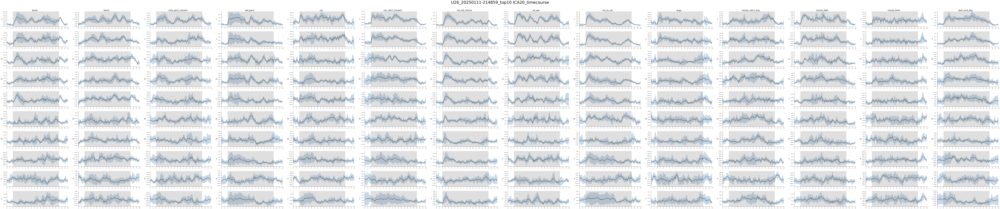

CPU times: user 51.9 s, sys: 1.59 s, total: 53.5 s
Wall time: 53.8 s


In [30]:
%%time
subplot_timecourse(timecourse1, IC_idx+1, movie_name_list, title=f'{mouse}_{experiment}_top10 ICA{n_IC}_timecourse', outpath=path_out_ICA, pre_length=20, n_frame=150, plot_rep=False, dpi=200)


### superimpose retinotopy

In [23]:
# ##%% load patch data

# path_retinotopy = r'/home/lzx/data/WF_VC_liuzhaoxi/24.01.03_C83/retinotopy/process/20240103-123936-retinotopy'

# with open(pjoin(path_retinotopy, 'retinotopy_out.pkl'), 'rb') as f:
#     retino = pickle.load(f)
# f.close()
# n_patch = len(retino['finalPatchesMarked'])


In [ ]:
# # plot top10 spatial IC

# IC_arrayz_cut1=IC_arrayz_cut[IC_idx]

# nrow = 2
# ncol = 5
# dpi = 200

# fig, ax = plt.subplots(nrow, ncol, figsize=(U.shape[0] / dpi * ncol, U.shape[1] / dpi * nrow), dpi=dpi)
# for irow in range(nrow):
#     for icol in range(ncol):
#         iIC = irow * ncol + icol
#         ax[irow, icol].imshow(frames_ave, cmap='gray')
#         img = ax[irow, icol].imshow(IC_arrayz_cut1[iIC], cmap='coolwarm', clim=[-5,5], alpha=0.5)
#         ax[irow, icol].set_title('IC{}'.format(IC_idx[iIC] + 1), fontsize=10)
#         ax[irow, icol].axis('off')

#         plot_borders(retino['finalPatchesMarked'], plotAxis=ax[irow, icol], title=None, zoom=1,
#                  borderWidth=1, isColor=False, plotName=True, fontSize=7)
        
#         fig.colorbar(img)
# fig.set_facecolor('white')
# fig.suptitle(experiment+f'\ntop10 spatial IC-{n_IC}({ICA_methods}) (cut={z_cut})', fontsize=16)
# plt.tight_layout(rect=[0, 0, 1, 0.99])
# plt.savefig(pjoin(path_out_ICA, experiment+f' top10 spatial IC{n_IC}--VA.png'), bbox_inches='tight', pad_inches=0)
# plt.show()


In [ ]:
# IC_sum = np.sum(np.abs(IC_arrayz_cut), axis=0)

# fig,ax = plt.subplots()
# plt.imshow(frames_ave, cmap='gray')
# plt.imshow(IC_sum, cmap='Reds', vmin=z_cut, vmax=z_cut*5, alpha=0.5)
# plot_borders(retino['finalPatchesMarked'], plotAxis=ax, title=None, zoom=1,
#                  borderWidth=1, isColor=True, plotName=True, fontSize=7)

# plt.axis('off')
# plt.colorbar()
# fig.set_facecolor('white')
# plt.title(experiment+f'\nsum spatial_IC-{n_IC}({ICA_methods})')
# plt.savefig(pjoin(path_out_ICA, experiment+f' sum spatial_IC{n_IC}--VA.png'), bbox_inches='tight', pad_inches=0)
# plt.show()